In [1]:
# Python Libraries
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from scipy.optimize import newton
import pandas as pd

# Hamiltonian systems


### Example: Simple Pendulum
Hamiltonian system

\begin{eqnarray}
\frac{d p}{dt} & = &- (\frac{g}{ L}) \sin(q) \\ 
\frac{d q}{dt} & = & p
\end{eqnarray}

Hamiltonian function: $H(p,q) = \frac{1}{2} p^{2} - (\frac{g}{L})\cos (q)$. Note that
\begin{eqnarray}
\frac{\partial H}{\partial q} & = & (\frac{g}{L})\sin(q) \\
\frac{\partial H}{\partial p} & = & p 
\end{eqnarray}

Symplectic Euler method:
\begin{eqnarray}
p_h^{n+1} & = & p_h^{n} + h(- (\frac{g}{L})\sin(q_h^{n})) \\ 
q_h^{n+1} & = & q_h^{n} + h( p_h^{n+1})
\end{eqnarray}

In [4]:
# Euler Methods:
def Forward_Euler( h,Max_steps, y0, odefun): # Forward Euler methods approximating dy/dt = odefun(t,y), y(0) = y0
    yh = np.zeros((Max_steps+1, y0.size))
    yh[0,:] = y0
    for j in range(0, Max_steps):
        yh[j+1,:] = yh[j,:] + h*odefun(tn[j], yh[j,:]) 
    return yh

from scipy.optimize import fsolve
def Backward_Euler( h, Max_steps, y0, odefun):
    yh = np.zeros((Max_steps+1, y0.size))
    yh[0,:] = y0
    for j in range(0, Max_steps):
        be_fun = lambda y: y - h*odefun(tn[j+1], y) - yh[j,:]
        yh[j+1,:] = fsolve(be_fun, yh[j,:])
    return  yh
def Symplectic_Euler(h, Max_steps, p0, q0 , H_q, H_p):
    ph = np.zeros(Max_steps+1)
    qh = np.zeros(Max_steps+1)
    ph[0] = p0
    qh[0] = q0
    print("h:", h)
    for j in range(0, Max_steps):
        ph[j+1] = ph[j] - h*H_q(tn[j], ph[j+1], qh[j] )
        qh[j+1] = qh[j] + h*H_p(tn[j], ph[j+1], qh[j] )
    return (ph, qh)


h: 0.01


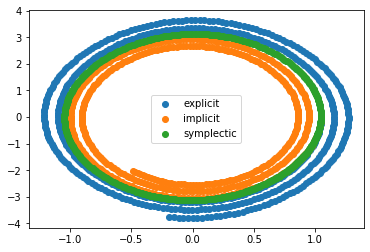

In [16]:
%matplotlib inline
# Fix h
h = 0.01
N = 1000
g = 9.8
L = 1

def Math_pendulum(t, y):
    #p = y[0]
    #q = y[1]
    p,q = y
    f1 = -(g/ L)*np.sin(q)
    f2 = p
    return np.array([f1,f2])

def Math_pendulum_Hq(t, p,q):
    f1 = (g/ L)*np.sin(q)
    return f1

def Math_pendulum_Hp(t, p,q):
    f2 = p
    return f2

def Energy_pendulum(p,q):
    return 0.5*p**2-(g/ L)*np.cos(q)

p0 = 0
q0 = np.pi/3
y0 = np.array([p0,q0])

# Forward Euler solution
y_fe = Forward_Euler(h, N, y0, Math_pendulum )
p_fe = y_fe[:,0]
q_fe = y_fe[:,1]
# Backward Euler solution
y_be = Backward_Euler(h, N, y0, Math_pendulum )
p_be = y_be[:,0]
q_be = y_be[:,1]
# Symplectic Euler soluton
p_se, q_se = Symplectic_Euler(h, N, p0, q0 , Math_pendulum_Hq, Math_pendulum_Hp)
#print(p_se[:5], q_se[:5])

plt.plot(q_fe[:500],p_fe[:500],'oC0')
plt.plot(q_be[:500],p_be[:500],'oC1')
plt.plot(q_se[:500],p_se[:500],'oC2')

plt.legend(['explicit','implicit', 'symplectic'])
plt.show()

H_fe = Energy_pendulum(p_fe, q_fe)
H_be = Energy_pendulum(p_be, q_be)
H_se = Energy_pendulum(p_se, q_se)

In [17]:
# pendulum simulation


import matplotlib
from matplotlib import animation, rc

import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation

#C:\Users\msanc\Anaconda3\Lib\site-packages
#Writer = animation.FFMpegWriter(fps=30, codec='libx264') # Or 
#Writer = animation.FFMpegWriter(fps=20, metadata=dict(artist='Me'), bitrate=1800) 
#matplotlib.rcParams['animation.writer'] = 'imagemagick'
from IPython.display import HTML

%matplotlib agg

x_fe = L*np.sin(q_fe)
y_fe = -L*np.cos(q_fe)

x_be = L*np.sin(q_be)
y_be = -L*np.cos(q_be)

x_se = L*np.sin(q_se)
y_se = -L*np.cos(q_se)
fig, ax = plt.subplots(1,3, figsize=(12,5));
titulo = fig.suptitle(' ')

ax[0].set_title('Forward Euler')
ax[1].set_title('Backward Euler')
ax[2].set_title('Symplectic Euler')

#ax = fig.add_subplot(131, aspect='equal', autoscale_on=False,
                    #xlim=(-L-0.5, L+0.5), ylim=(-L-0.5, 0.5))
#ax2 = fig.add_subplot(132, aspect='equal', autoscale_on=False,
                    #xlim=(-L-0.5, L+0.5), ylim=(-L-0.5, 0.5))
#ax.grid()
bar,  = ax[0].plot( [-.5, .5], [0,0], '-k', lw = 5); 
ball, = ax[0].plot([], [], 'o', markersize = 30, color='C0');
chord, = ax[0].plot([], [], '-', lw = 2, color='C7');

ax[0].set_xlim([-L-0.5, L+0.5]);
ax[0].set_ylim([-L-0.5, .5]);
time_text = ax[0].text(0.02, 0.95, '', transform=ax[0].transAxes);
energy_text = ax[0].text(0.02, 0.90, '', transform=ax[0].transAxes);


bar2,  = ax[1].plot( [-.5, .5], [0,0], '-k', lw = 5) ;
ball2, = ax[1].plot([], [], 'o', markersize = 30, color='C1');
chord2, = ax[1].plot([], [], '-', lw = 2, color='C7');
energy_text2 = ax[1].text(0.02, 0.90, '', transform=ax[1].transAxes);

ax[1].set_xlim([-L-0.5, L+0.5]);
ax[1].set_ylim([-L-0.5, .5]);

bar3,  = ax[2].plot( [-.5, .5], [0,0], '-k', lw = 5) ;
ball3, = ax[2].plot([], [], 'o', markersize = 30, color='C2');
chord3, = ax[2].plot([], [], '-', lw = 2, color='C7');
energy_text3 = ax[2].text(0.02, 0.90, '', transform=ax[2].transAxes);

ax[2].set_xlim([-L-0.5, L+0.5]);
ax[2].set_ylim([-L-0.5, .5]);
#time_text = ax[2].text(0.02, 0.95, '', transform=ax[2].transAxes)

def init():
    """initialize animation"""
    ball.set_data([], []);
    chord.set_data([], []);
    time_text.set_text('');
    energy_text.set_text('')
    
    ball2.set_data([], []);
    chord2.set_data([], []);
    #time_text2.set_text('')
    energy_text2.set_text('')
    
    ball3.set_data([], []);
    chord3.set_data([], []);
    #time_text3.set_text('')
    energy_text3.set_text('');
    
    titulo.set_text('')
    return ball, chord, time_text, energy_text, ball2, chord2,energy_text2, ball3, chord3,energy_text3, titulo

def animate(point):
    """perform animation step"""
    #global pendulum, dt
    #pendulum.step(dt)
    point = 10*point
    tn = point*h
    ball.set_data(x_fe[point], y_fe[point])
    chord.set_data([0, x_fe[point]], [0, y_fe[point]])
    energy_text.set_text('energy = %.3f J' % -H_fe[point])
    
    ball2.set_data(x_be[point], y_be[point])
    chord2.set_data([0, x_be[point]], [0, y_be[point]])
    energy_text2.set_text('energy = %.3f J' % -H_be[point])
    
    ball3.set_data(x_se[point], y_se[point])
    chord3.set_data([0, x_se[point]], [0, y_se[point]])
    energy_text3.set_text('energy = %.3f J' % -H_se[point])
    
    
    fig.suptitle('Time = %.1f' %tn)
    return ball, chord, time_text, energy_text, ball2, chord2,energy_text2, ball3, chord3, energy_text3, titulo


# choose the interval based on dt and the time to animate one step
from time import time
dt = h
t0 = time()
animate(0)
t1 = time()
interval = 10000 * dt - (t1 - t0)

%matplotlib agg

In [18]:
#ani = animation.FuncAnimation(fig, animate, frames=10, interval=interval, blit=True, init_func=init);
ani = animation.FuncAnimation(fig, animate, frames=100, interval=interval, blit=False, init_func=init);


# equivalent to rcParams['animation.html'] = 'html5'
HTML(ani.to_jshtml())



### Problem 3: The three-body problem

Notation and assumptions:
- $M_s$: mass of the Sun
- $M_e$: mass of the Earth
- $M_m$: mass of Mars
- $M_s \approx 330000 M_e$,  $M_m \approx 0.1 M_e$
- Center of gravity of the three bodies approximately coincides with the center of the Sun (Sun remain still in the model)
- The three objects remain in the same plane described by their initial positions (2D problem)
- $\mathbf{x}_e = (x_e, y_e)$ denote the earth position.
- $\mathbf{x}_m = (x_m, y_m)$ denote the earth position.


Universal gravitational law

\begin{eqnarray}
M_e\frac{d^{2} \mathbf{x}_e}{dt^{2}} & = & G M_m M_e \frac{\mathbf{x}_m-\mathbf{x}_e}{\|\mathbf{x}_m-\mathbf{x}_e\|^{3}}  -G M_e M_s\frac{\mathbf{x}_e}{\|\mathbf{x}_e\|^{3}} \\
M_m\frac{d^{2} \mathbf{x}_m}{dt^{2}} & = & G M_e M_m \frac{\mathbf{x}_e-\mathbf{x}_m}{\|\mathbf{x}_e-\mathbf{x}_m\|^{3}}  -G M_m M_s\frac{\mathbf{x}_m}{\|\mathbf{x}_m\|^{3}} 
\end{eqnarray}

non-dimensional

\begin{eqnarray}
\frac{d^{2} \mathbf{x}_e}{dt^{2}} & = & 4 \pi^2\left(  \frac{M_m}{M_s} \frac{\mathbf{x}_m-\mathbf{x}_e}{\|\mathbf{x}_m-\mathbf{x}_e\|^{3}}  -\frac{\mathbf{x}_e}{\|\mathbf{x}_e\|^{3}} \right)\\
\frac{d^{2} \mathbf{x}_m}{dt^{2}} & = & 4 \pi^2\left(  \frac{M_e}{M_s} \frac{\mathbf{x}_e-\mathbf{x}_m}{\|\mathbf{x}_e-\mathbf{x}_m\|^{3}}  -\frac{\mathbf{x}_m}{\|\mathbf{x}_m\|^{3}} \right)
\end{eqnarray}

We introduce the variables 
\begin{eqnarray}
\mathbf{q} &=& \left(q_1, q_2, q_3, q_4\right) = \left(x_e, y_e, x_m, y_m\right)  \\
\mathbf{p} &=& \left(p_1, p_2, p_3, p_4\right) = \left(M_e\frac{d x_e}{dt}, M_e\frac{d y_e}{dt}, M_m\frac{d x_m}{dt}, M_m \frac{d y_m}{dt} \right) 
\end{eqnarray}

Hamiltonian system:
\begin{eqnarray}
\frac{d q_1}{dt} & = & \frac{p_1}{M_e}\\
\frac{d q_2}{dt} & = & \frac{p_2}{M_e}\\
\frac{d q_3}{dt} & = & \frac{p_3}{M_m}\\
\frac{d q_4}{dt} & = & \frac{p_4}{M_m}\\
\frac{1}{M_e}\frac{d p_1}{dt} & = & 4 \pi^2\left(  \frac{M_m}{M_s} \frac{q_3-q_1}{\|(q_3,q_4)-(q_1, q_2)\|^{3}}  -\frac{q_1}{\|(q_1, q_2)\|^{3}} \right) \\
\frac{1}{M_e}\frac{d p_3}{dt} & = & 4 \pi^2\left(  \frac{M_m}{M_s} \frac{q_4-q_2}{\|(q_3,q_4)-(q_1, q_2)\|^{3}}  -\frac{q_2}{\|(q_1, q_2)\|^{3}} \right)\\
\frac{1}{M_m}\frac{d p_3}{dt} & = & 4 \pi^2\left(  \frac{M_e}{M_s} \frac{q_1-q_3}{\|(q_1,q_2)-(q_3, q_4)\|^{3}}  -\frac{q_3}{\|(q_3, q_4)\|^{3}} \right) \\
\frac{1}{M_m}\frac{d p_4}{dt} & = & 4 \pi^2\left(  \frac{M_e}{M_s} \frac{q_2-q_4}{\|(q_1,q_2)-(q_3, q_4)\|^{3}}  -\frac{q_4}{\|(q_3, q_4)\|^{3}} \right)
\end{eqnarray}

Hamiltonian: $ \mathbf{p} = (p_1,p_2,p_3,p_4), \mathbf{q} = (q_1,q_2,q_3,q_4)$

\begin{equation}
H(\mathbf{p}, \mathbf{q}) = \frac{1}{2}\left(\frac{p_1^{2}}{M_e}+\frac{p_2^{2}}{M_e}+\frac{p_3^{2}}{M_m}+\frac{p_4^{2}}{M_m} \right) - \frac{4 \pi^2}{M_s}\left( M_{e} M_{m} \frac{1}{\|(q_1,q_2)-(q_3, q_4)\|} + M_{e} M_{s} \frac{1}{\|(q_1, q_2)\|} + M_{m} M_{s} \frac{1}{\|(q_3, q_4)\|} \right) 
\end{equation}

In [6]:

M_e = 1.0
M_m = 0.1
M_s = 330000.0

def threebody_problem_Hp(t,p,q):
    f1 = p[0]/M_e
    f2 = p[1]/M_e
    f3 = p[2]/M_m
    f4 = p[3]/M_m
    return np.array([f1,f2,f3,f4])

def threebody_problem_Hq(t,p,q):
    f1 = -M_e*4*np.pi**2*( M_m/M_s * (q[2]-q[0])/((q[2]-q[0])**2+(q[3]-q[1])**2 )**(3/2) - q[0]/(q[0]**2+q[1]**2)**(3/2))
    f2 = -M_e*4*np.pi**2*( M_m/M_s * (q[3]-q[1])/((q[2]-q[0])**2+(q[3]-q[1])**2 )**(3/2) - q[1]/(q[0]**2+q[1]**2)**(3/2))
    f3 = -M_m*4*np.pi**2*( M_e/M_s * (q[2]-q[0])/((q[2]-q[0])**2+(q[3]-q[1])**2 )**(3/2) - q[2]/(q[2]**2+q[3]**2)**(3/2))
    f4 = -M_m*4*np.pi**2*( M_e/M_s * (q[3]-q[1])/((q[2]-q[0])**2+(q[3]-q[1])**2 )**(3/2) - q[3]/(q[2]**2+q[3]**2)**(3/2))

    return np.array([f1,f2,f3,f4])

In [12]:
def Symplectic_Euler_system(h, Max_steps, p0, q0 , H_q, H_p):
    ph = np.zeros((Max_steps+1, p0.size))
    qh = np.zeros((Max_steps+1, q0.size))
    ph[0,:] = p0
    qh[0,:] = q0
    
    for j in range(0, Max_steps):
        ph[j+1,:] = ph[j,:] - h*H_q(tn[j], ph[j+1,:], qh[j,:] )
        qh[j+1,:] = qh[j,:] + h*H_p(tn[j], ph[j+1,:], qh[j,:] )
        
    return (ph, qh)

def Forward_Euler_system(h, Max_steps, p0, q0 , H_q, H_p):
    ph = np.zeros((Max_steps+1, p0.size))
    qh = np.zeros((Max_steps+1, q0.size))
    ph[0,:] = p0
    qh[0,:] = q0
    
    for j in range(0, Max_steps):
        ph[j+1,:] = ph[j,:] - h*H_q(tn[j], ph[j,:], qh[j,:] )
        qh[j+1,:] = qh[j,:] + h*H_p(tn[j], ph[j,:], qh[j,:] )
        #print(qh)
        #stop
    return (ph, qh)

def RK4_system(tn, y0, odefun): # A = [0,0,0,0;1/2,0,0,0;0,1/2,0,0; 0,0,1,0], c = [0,1/2,1/2,1], b = [1/6, 1/3,1/3, 1/6]
    yh = np.zeros((tn.size, y0.size))
    yh[0,:] = y0
    for j in range(0, tn.size-1):
        h = tn[j+1]-tn[j]
        K1 = odefun(tn[j], yh[j,:])
        K2 = odefun(tn[j]+0.5*h, yh[j,:]+h*0.5*K1)
        K3 = odefun(tn[j]+0.5*h, yh[j,:]+h*(0.5*K2))
        K4 = odefun(tn[j+1], yh[j,:]+h*(1*K3))
        yh[j+1,:] = yh[j,:]+(h)*(1.0/6.0*K1+1.0/3.0*K2+1.0/3.0*K3+1.0/6.0*K4)
    return yh


In [13]:
h = 10/20000
N = 20000
tn = np.linspace(0,10, N)
 
p0 = np.array([0,-5.1, 0, -0.46])
q0 = np.array([1,0,1.52,0])

p_se, q_se = Symplectic_Euler_system(h, N, p0, q0 , threebody_problem_Hq, threebody_problem_Hp)
p_fe, q_fe = Forward_Euler_system(h, N, p0, q0 , threebody_problem_Hq, threebody_problem_Hp)


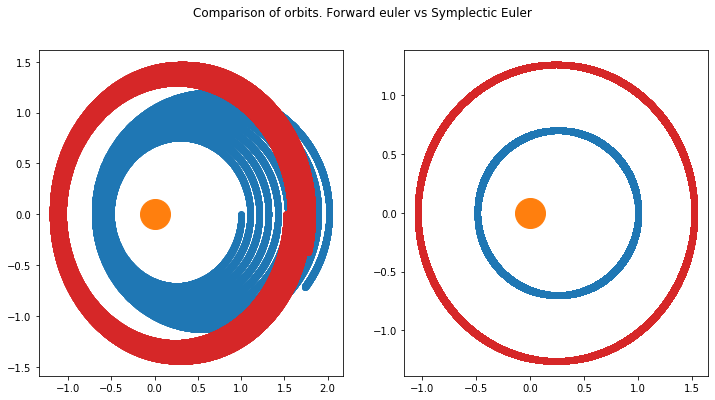

In [14]:
%matplotlib inline
import matplotlib.pyplot as plt
earth_pos_x_fe = q_fe[:,0]
earth_pos_y_fe = q_fe[:,1]
mars_pos_x_fe  = q_fe[:,2]
mars_pos_y_fe  = q_fe[:,3]

earth_pos_x = q_se[:,0]
earth_pos_y = q_se[:,1]
mars_pos_x  = q_se[:,2]
mars_pos_y  = q_se[:,3]

fig1, ax1 = plt.subplots(1,2, figsize=(12,6));
fig1.suptitle('Comparison of orbits. Forward euler vs Symplectic Euler')

ax1[0].plot(0,0, 'oC1', markersize = 30)
ax1[0].plot(earth_pos_x_fe,earth_pos_y_fe,'oC0')
ax1[0].plot(mars_pos_x_fe,mars_pos_y_fe,'oC3')

ax1[1].plot(0,0, 'oC1', markersize = 30)
ax1[1].plot(earth_pos_x,earth_pos_y,'oC0')
ax1[1].plot(mars_pos_x,mars_pos_y,'oC3')
#plt.plot(q_se[:300],p_se[:300],'oC2')

#plt.legend(['explicit','implicit', 'symplectic'])
plt.show()

In [15]:
# Thre-body simulation
import matplotlib
from matplotlib import animation, rc

import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation

fig3, ax3 = plt.subplots(1,1, figsize=(10,7));
#titulo = fig3.suptitle(' ')

#ax3[0].set_title('Forward Euler')
#ax3[0].set_xlim([-2, 2]);
#ax3[0].set_ylim([-1.5, 1.5]);

ax3.set_title('Simulation of orbits: Symplectic Euler ')
ax3.set_xlim([-1.5, 2]);
ax3.set_ylim([-1.5, 1.5]);
sun1,  = ax3.plot( 0, 0, 'oC1', markersize = 30); 
#sun2,  = ax3[1].plot( 0, 0, 'oC1', markersize = 20); 

earth1, = ax3.plot([], [], 'o', markersize = 8, color='C0');
mars1,  = ax3.plot([], [], 'o', markersize = 5, color='C3');

tearth1, = ax3.plot([], [], '--',  color='C0');
tmars1,  = ax3.plot([], [], '--',  color='C3');

#earth2, = ax3[1].plot([], [], 'o', markersize = 5, color='C0');
#mars2,  = ax3[1].plot([], [], 'o', markersize = 5, color='C2');

time_text = ax3.text(0.02, 0.90, '', transform=ax3.transAxes);

def init0():
    """initialize animation"""
    earth1.set_data([], []);
    mars1.set_data([], []);
    tearth1.set_data([], []);
    tmars1.set_data([], []);
    #earth2.set_data([], []);
    #mars2.set_data([], []);
    time_text.set_text('')
    return earth1, mars1, tearth1, tmars1,time_text#, earth2, mars2

def animate0(point):
    """perform animation step"""
    #global pendulum, dt
    #pendulum.step(dt)
    point = 5*point
    tn = point*h
    
    earth1.set_data(earth_pos_x[point], earth_pos_y[point]);
    mars1.set_data(mars_pos_x[point], mars_pos_y[point]);
    tearth1.set_data(earth_pos_x[:point], earth_pos_y[:point]);
    tmars1.set_data(mars_pos_x[:point], mars_pos_y[:point]);
    #earth2.set_data(earth_pos_x[point], earth_pos_y[point]);
    #mars2.set_data(mars_pos_x[point], mars_pos_y[point]);
    time_text.set_text('Time = %.1f' %tn)
    
    #ax3.title('Time = %.1f' %tn)
    return earth1, mars1, tearth1, tmars1, time_text#, earth2, mars2


# choose the interval based on dt and the time to animate one step
from time import time
dt = h
t0 = time()
animate0(0)
t1 = time()
interval = 5000 * dt - (t1 - t0)

%matplotlib agg

In [43]:
ani = animation.FuncAnimation(fig3, animate0, frames=1000, interval=interval, blit=True, init_func=init0);
matplotlib.rcParams['animation.embed_limit'] = 20


# equivalent to rcParams['animation.html'] = 'html5'
HTML(ani.to_jshtml())

Animation size has reached 15756295 bytes, exceeding the limit of 15728640.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
